<p style = 'text-align:left;'>
<img src="https://upload.wikimedia.org/wikipedia/commons/thumb/6/6c/Javeriana.svg/1200px-Javeriana.svg.png" height="200" width="300">
</p>

<h1>Parcial 2 - Procesamiento de datos a gran escala</h1>

<h2>Fecha: 14/05/2024</h2>


<h4>Programas</h4>
<h5>Ciencia de datos e Ingeniería de Sistemas</h5>

<h4>Integrantes</h4>
<p>Santiago Botero Pacheco</p>
<p>Santiago Avilés Tibocha</p>


## Creación del entorno de trabajo (Pyspark y Python)

In [ ]:
#Importar bibliotecas para la exploración
import pyspark
from pyspark import SparkContext
from pyspark.sql import  SQLContext, SparkSession
from pyspark.sql.functions import *
from pyspark.sql.types import *
from pyspark.ml.feature import *
from pyspark.ml import Pipeline
from pyspark.ml.evaluation import *

from sklearn.metrics import roc_curve, auc
from matplotlib import *

import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

In [ ]:
#Crear el contexto de Pyspark para utilización de sus funciones
spark = SparkContext.getOrCreate()
spark = SparkSession.builder.appName("Proyecto1").getOrCreate()

sc = SparkContext.getOrCreate()
sql_c = SQLContext(sc)
sc

/databricks/spark/python/pyspark/sql/context.py:117: FutureWarning: Deprecated in 3.0.0. Use SparkSession.builder.getOrCreate() instead.
  warnings.warn(


SparkContext 

 Spark UI 

 
 Version 
 v3.3.2 
 Master 
 local[8] 
 AppName 
 Databricks Shell

## Descargar los datos

In [ ]:
#Cargar datos del Saber-Pro 

pandas_general = None
for i in range(1, 5):
    base_url = f"https://raw.githubusercontent.com/Aviles17/Tecnologia-SABERPRO/main/Procesado/Saber_Pro-Procesado-{i}.csv"
    df_temp  = pd.read_csv(base_url)
    if pandas_general is None:
        pandas_general = df_temp
    else:
        pandas_general = pd.concat([pandas_general, df_temp], ignore_index=True)


pandas_general.head(5)


,ESTU_COD_RESIDE_MCPIO,MOD_RAZONA_CUANTITAT_PUNT,MOD_COMUNI_ESCRITA_PUNT,MOD_LECTURA_CRITICA_PUNT,MOD_INGLES_PUNT,MOD_COMPETEN_CIUDADA_PUNT,AÑO,ESTU_PAIS_RESIDE_ENC,ESTU_NUCLEO_PREGRADO_ENC,ESTU_PRGM_ACADEMICO_ENC,ESTU_METODO_PRGM_ENC,ESTU_HORASSEMANATRABAJA_ENC,ESTU_GENERO_ENC,FAMI_EDUCACIONPADRE_ENC,FAMI_ESTRATOVIVIENDA_ENC,FAMI_TIENECOMPUTADOR_ENC,FAMI_TIENEINTERNET_ENC,FAMI_EDUCACIONMADRE_ENC
0,11001.0,161,174.0,139,161.0,128,2018,0.0,0.0,240.0,0.0,1.0,0.0,5.0,0.0,0.0,0.0,4.0
1,76736.0,147,170.0,171,188.0,182,2018,0.0,3.0,2.0,0.0,3.0,1.0,1.0,0.0,0.0,0.0,4.0
2,68081.0,185,157.0,178,106.0,169,2018,0.0,11.0,266.0,0.0,2.0,1.0,6.0,0.0,0.0,0.0,2.0
3,11001.0,114,132.0,139,135.0,126,2018,0.0,48.0,145.0,2.0,3.0,0.0,2.0,1.0,0.0,0.0,3.0
4,70001.0,120,127.0,152,121.0,127,2018,0.0,4.0,3.0,0.0,2.0,0.0,7.0,2.0,1.0,1.0,9.0


In [ ]:
#Cargar datos de cobertura
base_url = "https://raw.githubusercontent.com/Aviles17/Tecnologia-SABERPRO/main/Procesado/CoberturaProcesada.csv"
df_cobertura_pd = pd.read_csv(base_url)

df_cobertura_pd.head(5)

,AÑO,PROVEEDOR,COD MUNICIPIO,MUNICIPIO,COBERTURA 2G,COBERTURA 3G,"COBERTURA HSPA+, HSPA+DC",COBERTUTA 4G,COBERTURA LTE,COBERTURA 5G
0,2015,EMPRESA DE TELECOMUNICACIONES DE BOGOTA S.A. ESP,73001.0,IBAGUÉ,1,0,0,0,0,0
1,2015,COMUNICACION CELULAR S A COMCEL S A,68190.0,CIMITARRA,0,0,0,0,0,0
2,2015,ALMACENES EXITO INVERSIONES S.A.S.,54518.0,PAMPLONA,1,1,1,0,0,0
3,2015,COMUNICACION CELULAR S A COMCEL S A,19532.0,PATÍA,0,0,0,0,0,0
4,2015,COLOMBIA TELECOMUNICACIONES S.A. E.S.P.,76736.0,SEVILLA,0,0,1,0,0,0


In [ ]:
df_resultados_pro = sql_c.createDataFrame(pandas_general) #Convertir a PySpark
display(df_resultados_pro)

ESTU_COD_RESIDE_MCPIO,MOD_RAZONA_CUANTITAT_PUNT,MOD_COMUNI_ESCRITA_PUNT,MOD_LECTURA_CRITICA_PUNT,MOD_INGLES_PUNT,MOD_COMPETEN_CIUDADA_PUNT,AÑO,ESTU_PAIS_RESIDE_ENC,ESTU_NUCLEO_PREGRADO_ENC,ESTU_PRGM_ACADEMICO_ENC,ESTU_METODO_PRGM_ENC,ESTU_HORASSEMANATRABAJA_ENC,ESTU_GENERO_ENC,FAMI_EDUCACIONPADRE_ENC,FAMI_ESTRATOVIVIENDA_ENC,FAMI_TIENECOMPUTADOR_ENC,FAMI_TIENEINTERNET_ENC,FAMI_EDUCACIONMADRE_ENC
11001.0,161,174.0,139,161.0,128,2018,0.0,0.0,240.0,0.0,1.0,0.0,5.0,0.0,0.0,0.0,4.0
76736.0,147,170.0,171,188.0,182,2018,0.0,3.0,2.0,0.0,3.0,1.0,1.0,0.0,0.0,0.0,4.0
68081.0,185,157.0,178,106.0,169,2018,0.0,11.0,266.0,0.0,2.0,1.0,6.0,0.0,0.0,0.0,2.0
11001.0,114,132.0,139,135.0,126,2018,0.0,48.0,145.0,2.0,3.0,0.0,2.0,1.0,0.0,0.0,3.0
70001.0,120,127.0,152,121.0,127,2018,0.0,4.0,3.0,0.0,2.0,0.0,7.0,2.0,1.0,1.0,9.0
11001.0,128,165.0,169,159.0,124,2018,0.0,0.0,1.0,0.0,2.0,0.0,7.0,3.0,0.0,0.0,7.0
76520.0,108,157.0,148,115.0,142,2018,0.0,4.0,3.0,1.0,4.0,1.0,4.0,1.0,0.0,0.0,2.0
76001.0,127,136.0,119,139.0,121,2018,0.0,0.0,5.0,0.0,0.0,0.0,5.0,1.0,0.0,0.0,5.0
5360.0,134,164.0,127,127.0,121,2018,0.0,6.0,88.0,2.0,0.0,0.0,3.0,1.0,0.0,0.0,4.0
11001.0,134,143.0,173,164.0,173,2018,0.0,17.0,35.0,0.0,1.0,1.0,6.0,3.0,0.0,0.0,2.0


In [ ]:
df_cobertura = sql_c.createDataFrame(df_cobertura_pd) #Convertir a PySpark
display(df_cobertura)

AÑO,PROVEEDOR,COD MUNICIPIO,MUNICIPIO,COBERTURA 2G,COBERTURA 3G,"COBERTURA HSPA+, HSPA+DC",COBERTUTA 4G,COBERTURA LTE,COBERTURA 5G
2015,EMPRESA DE TELECOMUNICACIONES DE BOGOTA S.A. ESP,73001.0,IBAGUÉ,1,0,0,0,0,0
2015,COMUNICACION CELULAR S A COMCEL S A,68190.0,CIMITARRA,0,0,0,0,0,0
2015,ALMACENES EXITO INVERSIONES S.A.S.,54518.0,PAMPLONA,1,1,1,0,0,0
2015,COMUNICACION CELULAR S A COMCEL S A,19532.0,PATÍA,0,0,0,0,0,0
2015,COLOMBIA TELECOMUNICACIONES S.A. E.S.P.,76736.0,SEVILLA,0,0,1,0,0,0
2015,COLOMBIA TELECOMUNICACIONES S.A. E.S.P.,88564.0,PROVIDENCIA,1,1,0,0,0,0
2015,COMUNICACION CELULAR S A COMCEL S A,54498.0,OCAÑA,1,1,0,0,0,0
2015,COLOMBIA MOVIL S.A ESP,19455.0,MIRANDA,1,1,1,0,0,0
2015,COLOMBIA MOVIL S.A ESP,5789.0,TÁMESIS,1,1,1,0,0,0
2015,COLOMBIA MOVIL S.A ESP,5321.0,GUATAPE,1,1,1,0,0,0


## Combinar datasets

### Analisis EDA de las columnas usadas para la combinación

La combinación de los datasets se hara con relación a la columna Municipio y el año. La gracia es que cada estudiante tenga asociada la información de que tanta cobertura hay en su lugar de residencia, esto dependiendo del año y el lugar general (Municipio)

In [ ]:
df_cobertura.createOrReplaceTempView("data_cobertura")
df_resultados_pro.createOrReplaceTempView("data_saber")

In [ ]:
%sql
select ESTU_COD_RESIDE_MCPIO, `AÑO` from data_saber

ESTU_COD_RESIDE_MCPIO,AÑO
11001.0,2018
76736.0,2018
68081.0,2018
11001.0,2018
70001.0,2018
11001.0,2018
76520.0,2018
76001.0,2018
5360.0,2018
11001.0,2018


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

In [ ]:
%sql
select `AÑO`, `COD MUNICIPIO`, PROVEEDOR from data_cobertura

AÑO,COD MUNICIPIO,PROVEEDOR
2015,73001.0,EMPRESA DE TELECOMUNICACIONES DE BOGOTA S.A. ESP
2015,68190.0,COMUNICACION CELULAR S A COMCEL S A
2015,54518.0,ALMACENES EXITO INVERSIONES S.A.S.
2015,19532.0,COMUNICACION CELULAR S A COMCEL S A
2015,76736.0,COLOMBIA TELECOMUNICACIONES S.A. E.S.P.
2015,88564.0,COLOMBIA TELECOMUNICACIONES S.A. E.S.P.
2015,54498.0,COMUNICACION CELULAR S A COMCEL S A
2015,19455.0,COLOMBIA MOVIL S.A ESP
2015,5789.0,COLOMBIA MOVIL S.A ESP
2015,5321.0,COLOMBIA MOVIL S.A ESP


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Teniendo en consideración que hay varios proveedores por Municipio, es necesario hacer una agrupación para asi tener un dato centralizado de que tanta cobertura tiene el municipio

### Agrupar dataset de Cobertura para el merge

In [ ]:
from pyspark.sql.functions import sum, col

df_cobertura_grouped = df_cobertura.groupBy("COD MUNICIPIO", "AÑO")\
    .agg(
                   sum("COBERTURA 2G").alias("COBERTURA 2G"),
                   sum("COBERTURA 3G").alias("COBERTURA 3G"),
                   sum("COBERTURA HSPA+, HSPA+DC").alias("COBERTURA HSPA+, HSPA+DC"),
                   sum("COBERTUTA 4G").alias("COBERTUTA 4G"),
                   sum("COBERTURA LTE").alias("COBERTURA LTE"),
                   sum("COBERTURA 5G").alias("COBERTURA 5G")
               )
display(df_cobertura_grouped)

COD MUNICIPIO,AÑO,COBERTURA 2G,COBERTURA 3G,"COBERTURA HSPA+, HSPA+DC",COBERTUTA 4G,COBERTURA LTE,COBERTURA 5G
25178.0,2015,3,2,1,0,0,0
17867.0,2015,4,2,1,0,0,0
13600.0,2015,7,3,1,0,0,0
19548.0,2015,10,6,5,0,0,0
18205.0,2015,3,2,0,0,0,0
5789.0,2016,24,20,16,0,0,0
70702.0,2016,44,33,28,0,0,0
13052.0,2016,44,24,16,0,12,0
52250.0,2016,8,8,8,0,0,0
73870.0,2016,4,4,4,0,4,0


In [ ]:
display(df_cobertura_grouped.describe())

summary,COD MUNICIPIO,AÑO,COBERTURA 2G,COBERTURA 3G,"COBERTURA HSPA+, HSPA+DC",COBERTUTA 4G,COBERTURA LTE,COBERTURA 5G
count,10086,10086,10086,10086,10086,10086,10086,10086
mean,38649.78098354154,2018.9990085266707,21.080210192345827,19.551060876462422,15.301308744794765,7.251140194328773,4.4190957763236165,0.0
stddev,26509.798789105997,2.5818478907612326,21.273607983229677,19.289941798791293,17.246578049281887,15.298701218972267,8.080148109462208,0.0
min,5001.0,2015,0,0,0,0,0,0
max,99773.0,2023,286,287,275,261,212,0


### Combinación de los datos

In [ ]:
from pyspark.sql.functions import coalesce
df_combinado = df_resultados_pro.join(df_cobertura_grouped, 
                                     [df_resultados_pro["ESTU_COD_RESIDE_MCPIO"] == df_cobertura_grouped["COD MUNICIPIO"],
                                      df_resultados_pro["año"] == df_cobertura_grouped["año"]], 
                                     "left") \
                                .withColumn("COBERTURA 2G", coalesce("COBERTURA 2G", lit(0))) \
                                .withColumn("COBERTURA 3G", coalesce("COBERTURA 3G", lit(0))) \
                                .withColumn("COBERTURA HSPA+, HSPA+DC", coalesce("COBERTURA HSPA+, HSPA+DC", lit(0))) \
                                .withColumn("COBERTUTA 4G", coalesce("COBERTUTA 4G", lit(0))) \
                                .withColumn("COBERTURA LTE", coalesce("COBERTURA LTE", lit(0))) \
                                .withColumn("COBERTURA 5G", coalesce("COBERTURA 5G", lit(0)))

In [ ]:
display(df_combinado)

ESTU_COD_RESIDE_MCPIO,MOD_RAZONA_CUANTITAT_PUNT,MOD_COMUNI_ESCRITA_PUNT,MOD_LECTURA_CRITICA_PUNT,MOD_INGLES_PUNT,MOD_COMPETEN_CIUDADA_PUNT,AÑO,ESTU_PAIS_RESIDE_ENC,ESTU_NUCLEO_PREGRADO_ENC,ESTU_PRGM_ACADEMICO_ENC,ESTU_METODO_PRGM_ENC,ESTU_HORASSEMANATRABAJA_ENC,ESTU_GENERO_ENC,FAMI_EDUCACIONPADRE_ENC,FAMI_ESTRATOVIVIENDA_ENC,FAMI_TIENECOMPUTADOR_ENC,FAMI_TIENEINTERNET_ENC,FAMI_EDUCACIONMADRE_ENC,COD MUNICIPIO,AÑO,COBERTURA 2G,COBERTURA 3G,"COBERTURA HSPA+, HSPA+DC",COBERTUTA 4G,COBERTURA LTE,COBERTURA 5G
52356.0,155,162.0,148,123.0,185,2020,0.0,3.0,13.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,52356.0,2020,40,39,33,0,23,0
19142.0,127,177.0,136,109.0,140,2020,0.0,5.0,4.0,0.0,4.0,1.0,1.0,2.0,0.0,0.0,5.0,19142.0,2020,32,21,14,0,8,0
68755.0,108,123.0,111,127.0,136,2021,0.0,0.0,1.0,0.0,1.0,1.0,3.0,0.0,0.0,0.0,0.0,68755.0,2021,20,22,20,13,5,0
68755.0,176,166.0,173,168.0,189,2021,0.0,2.0,0.0,0.0,1.0,1.0,0.0,2.0,0.0,0.0,4.0,68755.0,2021,20,22,20,13,5,0
73349.0,126,185.0,126,128.0,113,2018,0.0,3.0,2.0,1.0,0.0,1.0,1.0,2.0,1.0,1.0,1.0,73349.0,2018,12,12,1,0,8,0
52356.0,194,176.0,190,167.0,182,2020,0.0,27.0,75.0,0.0,4.0,0.0,10.0,0.0,0.0,0.0,1.0,52356.0,2020,40,39,33,0,23,0
52356.0,114,104.0,110,131.0,84,2020,0.0,0.0,1.0,1.0,3.0,1.0,1.0,0.0,0.0,0.0,1.0,52356.0,2020,40,39,33,0,23,0
52356.0,108,166.0,142,128.0,129,2020,0.0,1.0,321.0,0.0,1.0,0.0,5.0,2.0,0.0,1.0,5.0,52356.0,2020,40,39,33,0,23,0
52356.0,190,129.0,171,191.0,117,2020,0.0,8.0,7.0,0.0,4.0,0.0,0.0,2.0,0.0,0.0,0.0,52356.0,2020,40,39,33,0,23,0
68755.0,163,173.0,175,207.0,188,2021,0.0,12.0,10.0,0.0,3.0,1.0,3.0,0.0,0.0,0.0,2.0,68755.0,2021,20,22,20,13,5,0


In [ ]:
df_combinado.printSchema()

root
 |-- ESTU_COD_RESIDE_MCPIO: double (nullable = true)
 |-- MOD_RAZONA_CUANTITAT_PUNT: long (nullable = true)
 |-- MOD_COMUNI_ESCRITA_PUNT: double (nullable = true)
 |-- MOD_LECTURA_CRITICA_PUNT: long (nullable = true)
 |-- MOD_INGLES_PUNT: double (nullable = true)
 |-- MOD_COMPETEN_CIUDADA_PUNT: long (nullable = true)
 |-- AÑO: long (nullable = true)
 |-- ESTU_PAIS_RESIDE_ENC: double (nullable = true)
 |-- ESTU_NUCLEO_PREGRADO_ENC: double (nullable = true)
 |-- ESTU_PRGM_ACADEMICO_ENC: double (nullable = true)
 |-- ESTU_METODO_PRGM_ENC: double (nullable = true)
 |-- ESTU_HORASSEMANATRABAJA_ENC: double (nullable = true)
 |-- ESTU_GENERO_ENC: double (nullable = true)
 |-- FAMI_EDUCACIONPADRE_ENC: double (nullable = true)
 |-- FAMI_ESTRATOVIVIENDA_ENC: double (nullable = true)
 |-- FAMI_TIENECOMPUTADOR_ENC: double (nullable = true)
 |-- FAMI_TIENEINTERNET_ENC: double (nullable = true)
 |-- FAMI_EDUCACIONMADRE_ENC: double (nullable = true)
 |-- COD MUNICIPIO: double (nullable = true)
 

## Tratamiento del dataset combinado (Procesamiento)

### Eliminar columnas repetidas

In [ ]:
df_combinado = df_combinado.drop("COD MUNICIPIO")
df_combinado_1 = df_combinado.drop("AÑO") #Elimina las dos columnas (No son necesarias igualmente)
df_combinado_1.printSchema()

root
 |-- ESTU_COD_RESIDE_MCPIO: double (nullable = true)
 |-- MOD_RAZONA_CUANTITAT_PUNT: long (nullable = true)
 |-- MOD_COMUNI_ESCRITA_PUNT: double (nullable = true)
 |-- MOD_LECTURA_CRITICA_PUNT: long (nullable = true)
 |-- MOD_INGLES_PUNT: double (nullable = true)
 |-- MOD_COMPETEN_CIUDADA_PUNT: long (nullable = true)
 |-- ESTU_PAIS_RESIDE_ENC: double (nullable = true)
 |-- ESTU_NUCLEO_PREGRADO_ENC: double (nullable = true)
 |-- ESTU_PRGM_ACADEMICO_ENC: double (nullable = true)
 |-- ESTU_METODO_PRGM_ENC: double (nullable = true)
 |-- ESTU_HORASSEMANATRABAJA_ENC: double (nullable = true)
 |-- ESTU_GENERO_ENC: double (nullable = true)
 |-- FAMI_EDUCACIONPADRE_ENC: double (nullable = true)
 |-- FAMI_ESTRATOVIVIENDA_ENC: double (nullable = true)
 |-- FAMI_TIENECOMPUTADOR_ENC: double (nullable = true)
 |-- FAMI_TIENEINTERNET_ENC: double (nullable = true)
 |-- FAMI_EDUCACIONMADRE_ENC: double (nullable = true)
 |-- COBERTURA 2G: long (nullable = false)
 |-- COBERTURA 3G: long (nullable = 

### Crear columna de puntaje global

Teniendo en consideración de que no existe información relacionada a como se califica el SABER PRO, se optara por hacer un promedio entre todas las competencias para tener una metrica estandar

In [ ]:
df_combinado_2 = df_combinado_1.withColumn("GLOBAL", 
                                      (df_combinado_1["MOD_RAZONA_CUANTITAT_PUNT"] + 
                                       df_combinado_1["MOD_COMUNI_ESCRITA_PUNT"] + 
                                       df_combinado_1["MOD_LECTURA_CRITICA_PUNT"] + 
                                       df_combinado_1["MOD_INGLES_PUNT"] + 
                                       df_combinado_1["MOD_COMPETEN_CIUDADA_PUNT"]) / 5)
display(df_combinado_2)

ESTU_COD_RESIDE_MCPIO,MOD_RAZONA_CUANTITAT_PUNT,MOD_COMUNI_ESCRITA_PUNT,MOD_LECTURA_CRITICA_PUNT,MOD_INGLES_PUNT,MOD_COMPETEN_CIUDADA_PUNT,ESTU_PAIS_RESIDE_ENC,ESTU_NUCLEO_PREGRADO_ENC,ESTU_PRGM_ACADEMICO_ENC,ESTU_METODO_PRGM_ENC,ESTU_HORASSEMANATRABAJA_ENC,ESTU_GENERO_ENC,FAMI_EDUCACIONPADRE_ENC,FAMI_ESTRATOVIVIENDA_ENC,FAMI_TIENECOMPUTADOR_ENC,FAMI_TIENEINTERNET_ENC,FAMI_EDUCACIONMADRE_ENC,COBERTURA 2G,COBERTURA 3G,"COBERTURA HSPA+, HSPA+DC",COBERTUTA 4G,COBERTURA LTE,COBERTURA 5G,GLOBAL
52356.0,155,162.0,148,123.0,185,0.0,3.0,13.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,40,39,33,0,23,0,154.6
19142.0,127,177.0,136,109.0,140,0.0,5.0,4.0,0.0,4.0,1.0,1.0,2.0,0.0,0.0,5.0,32,21,14,0,8,0,137.8
68755.0,108,123.0,111,127.0,136,0.0,0.0,1.0,0.0,1.0,1.0,3.0,0.0,0.0,0.0,0.0,20,22,20,13,5,0,121.0
68755.0,176,166.0,173,168.0,189,0.0,2.0,0.0,0.0,1.0,1.0,0.0,2.0,0.0,0.0,4.0,20,22,20,13,5,0,174.4
73349.0,126,185.0,126,128.0,113,0.0,3.0,2.0,1.0,0.0,1.0,1.0,2.0,1.0,1.0,1.0,12,12,1,0,8,0,135.6
52356.0,194,176.0,190,167.0,182,0.0,27.0,75.0,0.0,4.0,0.0,10.0,0.0,0.0,0.0,1.0,40,39,33,0,23,0,181.8
52356.0,114,104.0,110,131.0,84,0.0,0.0,1.0,1.0,3.0,1.0,1.0,0.0,0.0,0.0,1.0,40,39,33,0,23,0,108.6
52356.0,108,166.0,142,128.0,129,0.0,1.0,321.0,0.0,1.0,0.0,5.0,2.0,0.0,1.0,5.0,40,39,33,0,23,0,134.6
52356.0,190,129.0,171,191.0,117,0.0,8.0,7.0,0.0,4.0,0.0,0.0,2.0,0.0,0.0,0.0,40,39,33,0,23,0,159.6
68755.0,163,173.0,175,207.0,188,0.0,12.0,10.0,0.0,3.0,1.0,3.0,0.0,0.0,0.0,2.0,20,22,20,13,5,0,181.2


Databricks visualization. Run in Databricks to view.

### Reporte de calidad de los datos

In [ ]:
#Cantidad de valores nulos
null_counts = []

for column in df_combinado_2.columns:
    # Contar los valores nulos en la columna actual
    null_count = df_combinado_2.filter(df_combinado_2[column].isNull()).count()
    null_counts.append((column, null_count))

# Imprimir los recuentos de los valores por columna
for column, count in null_counts:
    print(f"Cantidad de valores nulos en la columna '{column}': {count}")

Cantidad de valores nulos en la columna 'ESTU_COD_RESIDE_MCPIO': 0
Cantidad de valores nulos en la columna 'MOD_RAZONA_CUANTITAT_PUNT': 0
Cantidad de valores nulos en la columna 'MOD_COMUNI_ESCRITA_PUNT': 0
Cantidad de valores nulos en la columna 'MOD_LECTURA_CRITICA_PUNT': 0
Cantidad de valores nulos en la columna 'MOD_INGLES_PUNT': 0
Cantidad de valores nulos en la columna 'MOD_COMPETEN_CIUDADA_PUNT': 0
Cantidad de valores nulos en la columna 'ESTU_PAIS_RESIDE_ENC': 0
Cantidad de valores nulos en la columna 'ESTU_NUCLEO_PREGRADO_ENC': 0
Cantidad de valores nulos en la columna 'ESTU_PRGM_ACADEMICO_ENC': 0
Cantidad de valores nulos en la columna 'ESTU_METODO_PRGM_ENC': 0
Cantidad de valores nulos en la columna 'ESTU_HORASSEMANATRABAJA_ENC': 0
Cantidad de valores nulos en la columna 'ESTU_GENERO_ENC': 0
Cantidad de valores nulos en la columna 'FAMI_EDUCACIONPADRE_ENC': 0
Cantidad de valores nulos en la columna 'FAMI_ESTRATOVIVIENDA_ENC': 0
Cantidad de valores nulos en la columna 'FAMI_T

## Correlación de datos

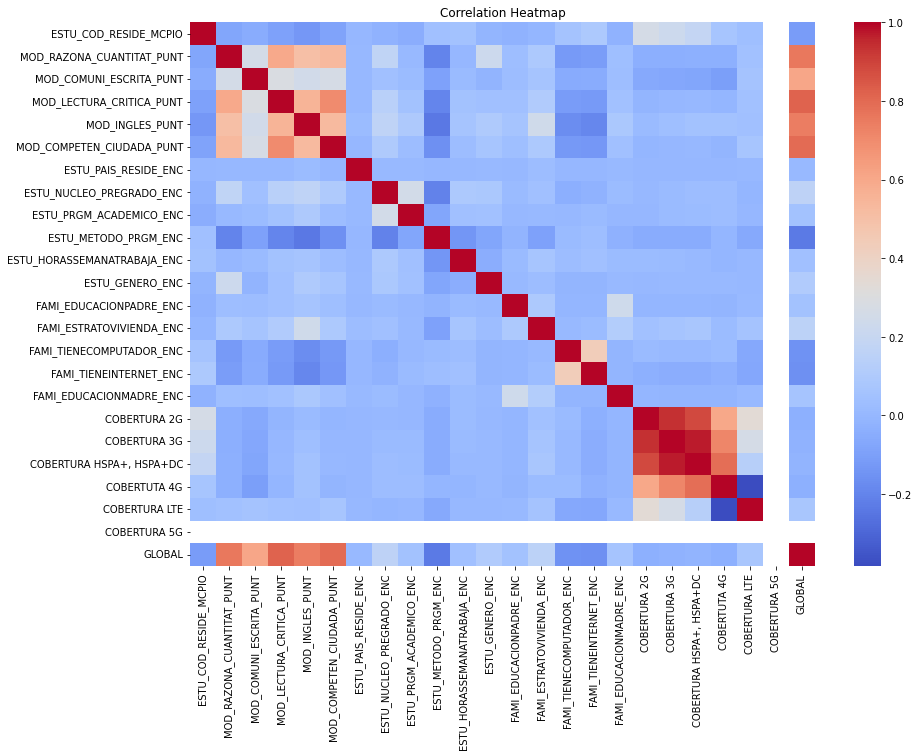

In [ ]:
plt.figure(figsize=(14, 10))
sns.heatmap(df_combinado_2.toPandas().corr(), annot=False, cmap="coolwarm", fmt=".2f")
plt.title("Correlation Heatmap")
plt.show()

## Preprocesamiento

### Primer modelo (Solo usando evidencias de conexión)

In [ ]:
ml_1 = df_combinado_2.select(["COBERTURA 2G","COBERTURA 3G","COBERTUTA 4G","COBERTURA 5G", "COBERTURA LTE", "COBERTURA HSPA+, HSPA+DC","FAMI_TIENECOMPUTADOR_ENC", "FAMI_TIENEINTERNET_ENC","GLOBAL"])
ml_1 = ml_1.withColumnRenamed("COBERTURA 2G", "cobertura_2g") \
                              .withColumnRenamed("COBERTURA 3G", "cobertura_3g") \
                              .withColumnRenamed("COBERTUTA 4G", "cobertura_4g") \
                              .withColumnRenamed("COBERTURA 5G", "cobertura_5g") \
                              .withColumnRenamed("COBERTURA LTE", "cobertura_lte") \
                              .withColumnRenamed("COBERTURA HSPA+, HSPA+DC", "cobertura_hspa") \
                              .withColumnRenamed("FAMI_TIENECOMPUTADOR_ENC", "tiene_computador") \
                              .withColumnRenamed("FAMI_TIENEINTERNET_ENC", "tiene_internet")

In [ ]:
display(ml_1)

cobertura_2g,cobertura_3g,cobertura_4g,cobertura_5g,cobertura_lte,cobertura_hspa,tiene_computador,tiene_internet,GLOBAL
40,39,0,0,23,33,0.0,0.0,154.6
32,21,0,0,8,14,0.0,0.0,137.8
20,22,13,0,5,20,0.0,0.0,121.0
20,22,13,0,5,20,0.0,0.0,174.4
12,12,0,0,8,1,1.0,1.0,135.6
40,39,0,0,23,33,0.0,0.0,181.8
40,39,0,0,23,33,0.0,0.0,108.6
40,39,0,0,23,33,0.0,1.0,134.6
40,39,0,0,23,33,0.0,0.0,159.6
20,22,13,0,5,20,0.0,0.0,181.2


In [ ]:
#Sabiendo que el objetivo es predecir el valor global utilizaremos como evidencia su disponibilidad a conexiones
feature_cols = ["cobertura_2g", "cobertura_3g", "cobertura_4g", "cobertura_5g",
                "cobertura_lte", "cobertura_hspa", "tiene_computador", "tiene_internet"]

feature_1 = VectorAssembler(inputCols=feature_cols, outputCol='features')
feature_vector_1 = feature_1.transform(ml_1)
display(feature_vector_1)

cobertura_2g,cobertura_3g,cobertura_4g,cobertura_5g,cobertura_lte,cobertura_hspa,tiene_computador,tiene_internet,GLOBAL,features
40,39,0,0,23,33,0.0,0.0,154.6,"Map(vectorType -> sparse, length -> 8, indices -> List(0, 1, 4, 5), values -> List(40.0, 39.0, 23.0, 33.0))"
32,21,0,0,8,14,0.0,0.0,137.8,"Map(vectorType -> sparse, length -> 8, indices -> List(0, 1, 4, 5), values -> List(32.0, 21.0, 8.0, 14.0))"
20,22,13,0,5,20,0.0,0.0,121.0,"Map(vectorType -> dense, length -> 8, values -> List(20.0, 22.0, 13.0, 0.0, 5.0, 20.0, 0.0, 0.0))"
20,22,13,0,5,20,0.0,0.0,174.4,"Map(vectorType -> dense, length -> 8, values -> List(20.0, 22.0, 13.0, 0.0, 5.0, 20.0, 0.0, 0.0))"
12,12,0,0,8,1,1.0,1.0,135.6,"Map(vectorType -> dense, length -> 8, values -> List(12.0, 12.0, 0.0, 0.0, 8.0, 1.0, 1.0, 1.0))"
40,39,0,0,23,33,0.0,0.0,181.8,"Map(vectorType -> sparse, length -> 8, indices -> List(0, 1, 4, 5), values -> List(40.0, 39.0, 23.0, 33.0))"
40,39,0,0,23,33,0.0,0.0,108.6,"Map(vectorType -> sparse, length -> 8, indices -> List(0, 1, 4, 5), values -> List(40.0, 39.0, 23.0, 33.0))"
40,39,0,0,23,33,0.0,1.0,134.6,"Map(vectorType -> dense, length -> 8, values -> List(40.0, 39.0, 0.0, 0.0, 23.0, 33.0, 0.0, 1.0))"
40,39,0,0,23,33,0.0,0.0,159.6,"Map(vectorType -> sparse, length -> 8, indices -> List(0, 1, 4, 5), values -> List(40.0, 39.0, 23.0, 33.0))"
20,22,13,0,5,20,0.0,0.0,181.2,"Map(vectorType -> dense, length -> 8, values -> List(20.0, 22.0, 13.0, 0.0, 5.0, 20.0, 0.0, 0.0))"


## Modelos de Regresión

### Modelo 1 - Evidencias Conectivas

In [ ]:
Lineal_1 = feature_vector_1.select(['features', 'GLOBAL'])
train_1, test_1 = Lineal_1.randomSplit([0.8,0.2])

In [ ]:
from pyspark.ml.regression import LinearRegression

lr_1 = LinearRegression(featuresCol='features', labelCol='GLOBAL')
lr_model_1 = lr_1.fit(train_1)

test_results = lr_model_1.evaluate(test_1)
print('Root Mean Squared Error (RMSE):', test_results.rootMeanSquaredError)
print('R-squared:', test_results.r2)

Root Mean Squared Error (RMSE): 24.431971244216843
R-squared: 0.04644018322525012


### Regresión con Random Forest

In [ ]:
from pyspark.ml.regression import RandomForestRegressor

rfr_1 = RandomForestRegressor(featuresCol='features', labelCol='GLOBAL')
rfr_model_1 = rfr_1.fit(train_1)

# Predecir valores
predictions = rfr_model_1.transform(test_1)

# Calcular metricas
evaluator = RegressionEvaluator(labelCol="GLOBAL", predictionCol="prediction", metricName="rmse")
rmse = evaluator.evaluate(predictions)

evaluator = RegressionEvaluator(labelCol="GLOBAL", predictionCol="prediction", metricName="r2")
r2 = evaluator.evaluate(predictions)

print("Root Mean Squared Error (RMSE):", rmse)
print("R-squared (R2):", r2)

Root Mean Squared Error (RMSE): 24.17675025887788
R-squared (R2): 0.06625825988127665


### Gradient boost Regression

In [ ]:
from pyspark.ml.regression import GBTRegressor

gbtr_1 = GBTRegressor(featuresCol='features', labelCol='GLOBAL')
gbtr_model_1 = gbtr_1.fit(train_1)

predictions = gbtr_model_1.transform(test_1)

evaluator = RegressionEvaluator(labelCol="GLOBAL", predictionCol="prediction", metricName="rmse")
rmse = evaluator.evaluate(predictions)

evaluator = RegressionEvaluator(labelCol="GLOBAL", predictionCol="prediction", metricName="r2")
r2 = evaluator.evaluate(predictions)

print("Root Mean Squared Error (RMSE):", rmse)
print("R-squared (R2):", r2)

Root Mean Squared Error (RMSE): 23.94803127491315
R-squared (R2): 0.08384162152510533


## Clustering

### Preprocesamiento

In [ ]:
assembler = VectorAssembler(inputCols=feature_cols, outputCol='features')
df_assembled = assembler.transform(ml_1)

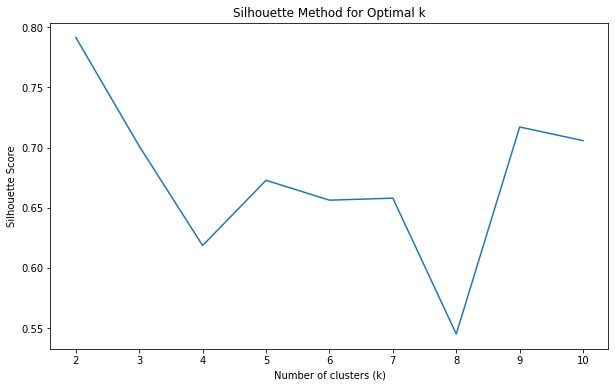

In [ ]:
from pyspark.ml.clustering import KMeans

silhouette_scores = []
for k in range(2, 11):
    kmeans = KMeans(k=k, featuresCol='features', seed=42)
    kmeans_model = kmeans.fit(df_assembled)
    predictions = kmeans_model.transform(df_assembled)
    
    evaluator = ClusteringEvaluator(predictionCol="prediction", featuresCol="features", metricName="silhouette")
    silhouette_score = evaluator.evaluate(predictions)
    silhouette_scores.append(silhouette_score)

# Plot the Silhouette Scores
plt.figure(figsize=(10, 6))
plt.plot(range(2, 11), silhouette_scores)
plt.xlabel('Number of clusters (k)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Method for Optimal k')
plt.show()

In [ ]:
from pyspark.ml.feature import Bucketizer
#Cambiar el label a rangos 
bucketizer = Bucketizer(splits=[-1, 37.5, 75, 112.5, 150, 187.5, 225, 262.5, 300], inputCol="GLOBAL", outputCol="label")

df_cluster = bucketizer.transform(df_assembled)

In [ ]:
display(df_cluster)

cobertura_2g,cobertura_3g,cobertura_4g,cobertura_5g,cobertura_lte,cobertura_hspa,tiene_computador,tiene_internet,GLOBAL,features,label
40,39,0,0,23,33,0.0,0.0,154.6,"Map(vectorType -> sparse, length -> 8, indices -> List(0, 1, 4, 5), values -> List(40.0, 39.0, 23.0, 33.0))",4.0
32,21,0,0,8,14,0.0,0.0,137.8,"Map(vectorType -> sparse, length -> 8, indices -> List(0, 1, 4, 5), values -> List(32.0, 21.0, 8.0, 14.0))",3.0
20,22,13,0,5,20,0.0,0.0,121.0,"Map(vectorType -> dense, length -> 8, values -> List(20.0, 22.0, 13.0, 0.0, 5.0, 20.0, 0.0, 0.0))",3.0
20,22,13,0,5,20,0.0,0.0,174.4,"Map(vectorType -> dense, length -> 8, values -> List(20.0, 22.0, 13.0, 0.0, 5.0, 20.0, 0.0, 0.0))",4.0
12,12,0,0,8,1,1.0,1.0,135.6,"Map(vectorType -> dense, length -> 8, values -> List(12.0, 12.0, 0.0, 0.0, 8.0, 1.0, 1.0, 1.0))",3.0
40,39,0,0,23,33,0.0,0.0,181.8,"Map(vectorType -> sparse, length -> 8, indices -> List(0, 1, 4, 5), values -> List(40.0, 39.0, 23.0, 33.0))",4.0
40,39,0,0,23,33,0.0,0.0,108.6,"Map(vectorType -> sparse, length -> 8, indices -> List(0, 1, 4, 5), values -> List(40.0, 39.0, 23.0, 33.0))",2.0
40,39,0,0,23,33,0.0,1.0,134.6,"Map(vectorType -> dense, length -> 8, values -> List(40.0, 39.0, 0.0, 0.0, 23.0, 33.0, 0.0, 1.0))",3.0
40,39,0,0,23,33,0.0,0.0,159.6,"Map(vectorType -> sparse, length -> 8, indices -> List(0, 1, 4, 5), values -> List(40.0, 39.0, 23.0, 33.0))",4.0
20,22,13,0,5,20,0.0,0.0,181.2,"Map(vectorType -> dense, length -> 8, values -> List(20.0, 22.0, 13.0, 0.0, 5.0, 20.0, 0.0, 0.0))",4.0


### Uso del algoritmo de K-means

In [ ]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
ml_1_pd = ml_1.toPandas()
scaler = StandardScaler()
X = scaler.fit_transform(ml_1_pd[["cobertura_2g", "cobertura_3g", "cobertura_4g", "cobertura_5g","cobertura_lte", "cobertura_hspa", "tiene_computador", "tiene_internet"]])

# Fit the KMeans model
n_clusters = 8  # Based on the elbow method
kmeans = KMeans(n_clusters=n_clusters, init='k-means++', random_state=42)
labels = kmeans.fit_predict(X)

# Add the cluster labels to the original DataFrame
ml_1_pd['cluster'] = labels

# Analyze the clusters
print(ml_1_pd.groupby('cluster').size())
print(ml_1_pd.groupby('cluster').mean())

cluster
0     69381
1    379862
2     82871
3     49738
4    220400
5     59520
6     39733
7    188942
dtype: int64
         cobertura_2g  cobertura_3g  cobertura_4g  cobertura_5g  \
cluster                                                           
0          184.830415    187.985169    124.025237           0.0   
1           22.018686     18.389520      4.560480           0.0   
2          130.359945    119.686139      0.000000           0.0   
3           49.346335     42.270900     14.756263           0.0   
4           71.312713     70.965463     54.254664           0.0   
5           44.107930     36.587601     11.134577           0.0   
6           51.064757     44.333954     18.251277           0.0   
7           69.693678     51.033762      0.000000           0.0   

         cobertura_lte  cobertura_hspa  tiene_computador  tiene_internet  \
cluster                                                                    
0            12.015854      169.656534          0.118577    

In [ ]:
from sklearn.metrics import silhouette_score

# Calculate the Silhouette score
silhouette = silhouette_score(X, labels)
print("Silhouette Score:", silhouette)

In [ ]:
from sklearn.metrics import calinski_harabasz_score
# Calculate the Calinski-Harabasz Index
ch = calinski_harabasz_score(X, labels)
print("Calinski-Harabasz Index:", ch)

In [ ]:
from sklearn.metrics import davies_bouldin_score
# Calculate the Davies-Bouldin Index
dbi = davies_bouldin_score(X, labels)
print("Davies-Bouldin Index:", dbi)